In [1]:
# importing modules
import torch.utils.data
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms # datasets for default datasets
from torchvision.io import read_image # for reading images from custom dataset
import numpy as np
import pandas as pd
from torch import nn, optim
import matplotlib.pyplot as plt

# setting device
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# mounting drive and defining DATASET_PATH
from google.colab import drive
drive.mount('/content/drive')
import sys
sys.path.append('/content/drive/My Drive/Project files')

# importing user defined modules
from dataset import BSD100DataSet, TrainSet, TestSet, DATASET_PATH
from model import DenoisingAutoencoder
from utils import PSNR, imshow_side_by_side, predict, test

# changing current working directory
import os
os.chdir(DATASET_PATH)



Mounted at /content/drive


In [2]:
transform = transforms.Compose([
    transforms.ToPILImage(), # important for Resize, Hflip and Vflip
    transforms.Resize((256, 256)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.ToTensor()
])

# initialise dataset
dataset = BSD100DataSet(dataset_path = DATASET_PATH, transform = transform)
# train_set = dataset[:90]
# test_set = dataset[90:]
train_set = TrainSet(dataset_path = DATASET_PATH, transform = transform)
test_set = TestSet(dataset_path = DATASET_PATH, transform = transform)

# initialise train and test dataloader
batch_size = 2
train_loader = torch.utils.data.DataLoader(
    train_set,
    batch_size=batch_size,
    shuffle=True)
test_loader = torch.utils.data.DataLoader(
    test_set,
    batch_size=5,
    shuffle=False)

In [3]:
model = DenoisingAutoencoder()
model = model.to(device)
NUM_EPOCHS = 100
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)


loss_list = []
accuracy_list = []

loss_aggregator = 0
accuracy_aggregator = 0

model.train()
for epoch in range(1, 1 + NUM_EPOCHS):
    for batch_idx, (data, target) in enumerate(train_loader):
        data = data.to(device)
        target = target.to(device)
        optimizer.zero_grad()
        output = model(data)
        loss = criterion(output, target)
        loss.backward()
        optimizer.step()
        accuracy = PSNR(output.detach().cpu().numpy(), target.detach().cpu().numpy())
        loss_list.append(loss.item())
        accuracy_list.append(accuracy)
        loss_aggregator += loss.item()/len(train_loader)
        accuracy_aggregator += accuracy/len(train_loader)

    loss_list.append(loss_aggregator)
    accuracy_list.append(accuracy_aggregator)

    if epoch % 10 == 0:
        print(f'Train Epoch: {epoch} [{(batch_idx + 1) * len(data)}/{len(train_loader) * len(data)}]\t Accuracy: {accuracy_aggregator:.1f} dB \tLoss: {loss_aggregator:.6f}')

    loss_aggregator = 0
    accuracy_aggregator = 0



Train Epoch: 10 [90/90]	 Accuracy: 19.4 dB 	Loss: 0.013395
Train Epoch: 20 [90/90]	 Accuracy: 20.5 dB 	Loss: 0.010305
Train Epoch: 30 [90/90]	 Accuracy: 21.0 dB 	Loss: 0.008715
Train Epoch: 40 [90/90]	 Accuracy: 20.8 dB 	Loss: 0.009448
Train Epoch: 50 [90/90]	 Accuracy: 21.7 dB 	Loss: 0.007178
Train Epoch: 60 [90/90]	 Accuracy: 21.7 dB 	Loss: 0.007091
Train Epoch: 70 [90/90]	 Accuracy: 22.8 dB 	Loss: 0.005828
Train Epoch: 80 [90/90]	 Accuracy: 22.2 dB 	Loss: 0.006477
Train Epoch: 90 [90/90]	 Accuracy: 22.7 dB 	Loss: 0.005827
Train Epoch: 100 [90/90]	 Accuracy: 23.0 dB 	Loss: 0.005235


(3, 256, 256)


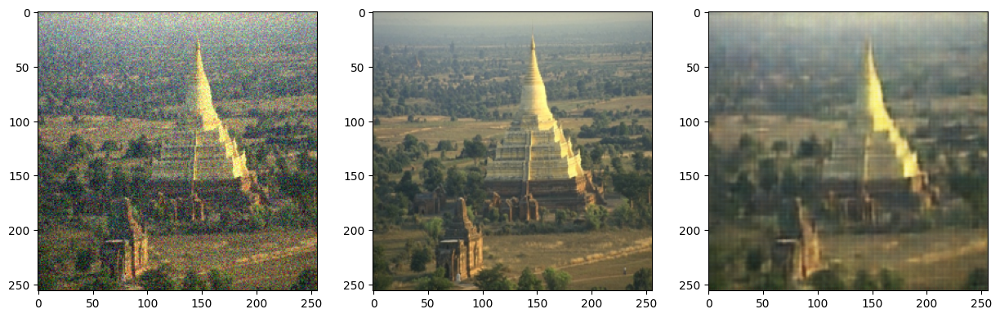

Accuracy: 27 dB
(3, 256, 256)


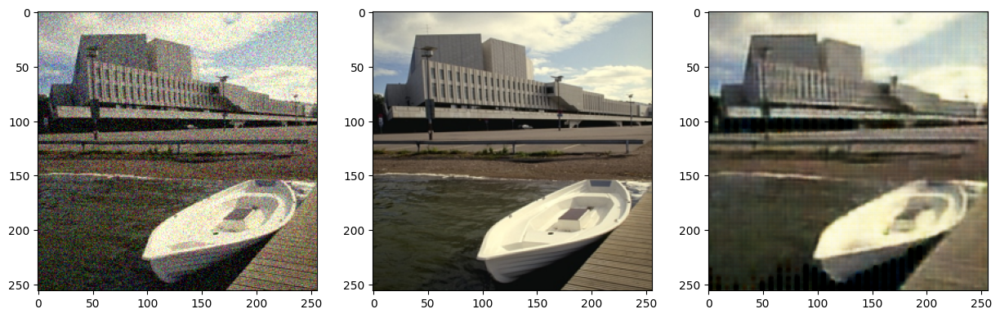

Accuracy: 25 dB
(3, 256, 256)


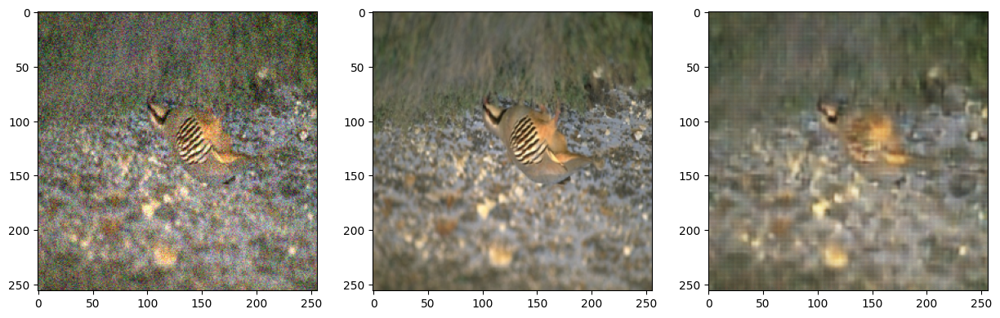

Accuracy: 26 dB
(3, 256, 256)


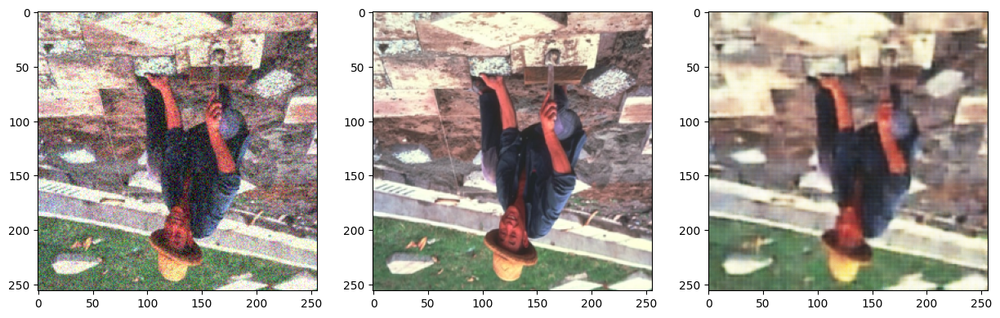

Accuracy: 23 dB
(3, 256, 256)


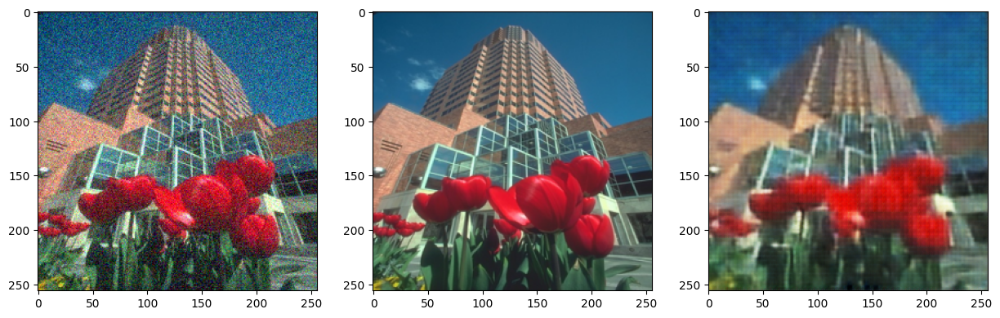

Accuracy: 23 dB
(3, 256, 256)


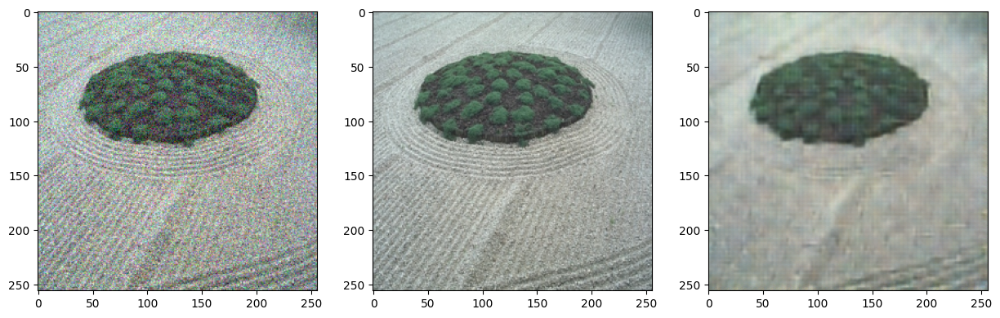

Accuracy: 24 dB
(3, 256, 256)


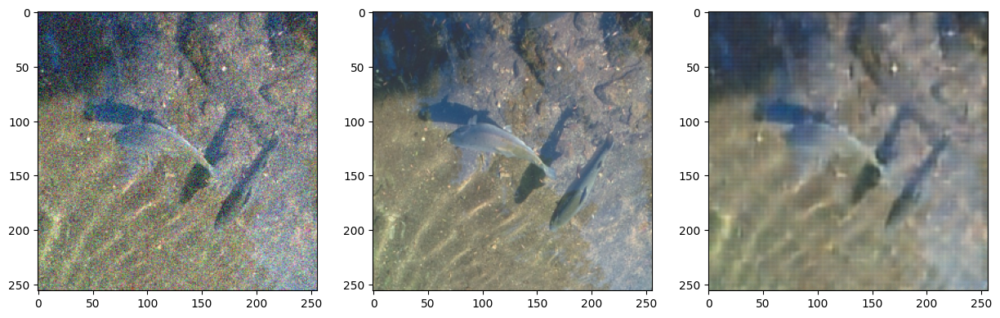

Accuracy: 27 dB
(3, 256, 256)


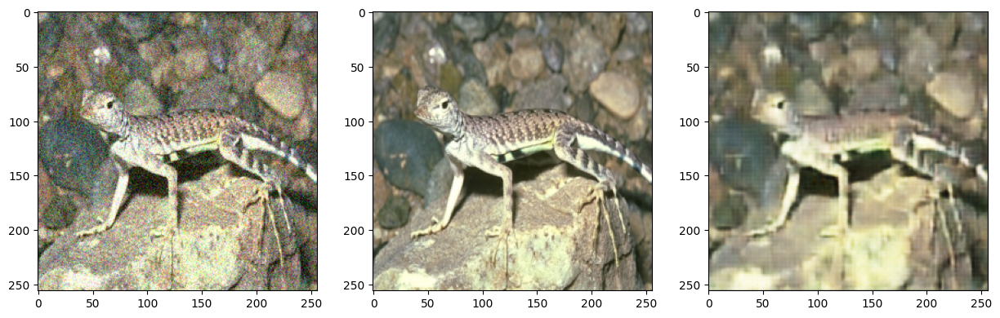

Accuracy: 24 dB
(3, 256, 256)


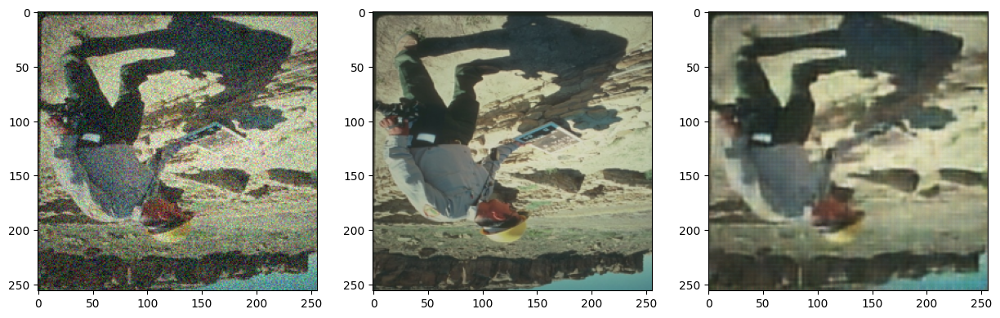

Accuracy: 25 dB
(3, 256, 256)


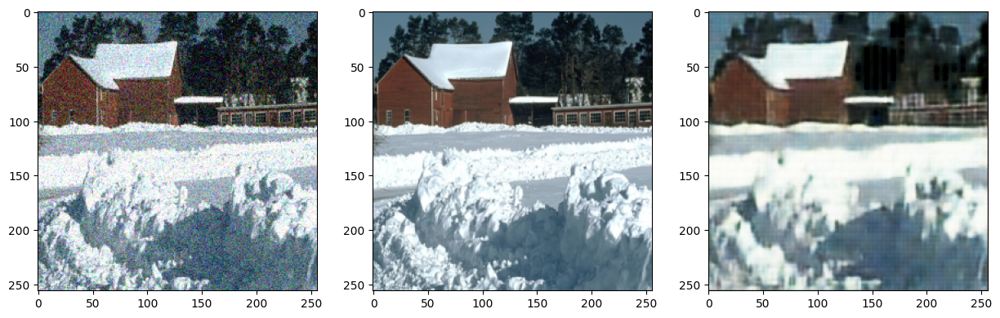

Accuracy: 23 dB
Test Accuracy: 25 dB
on train_set: 
(3, 256, 256)


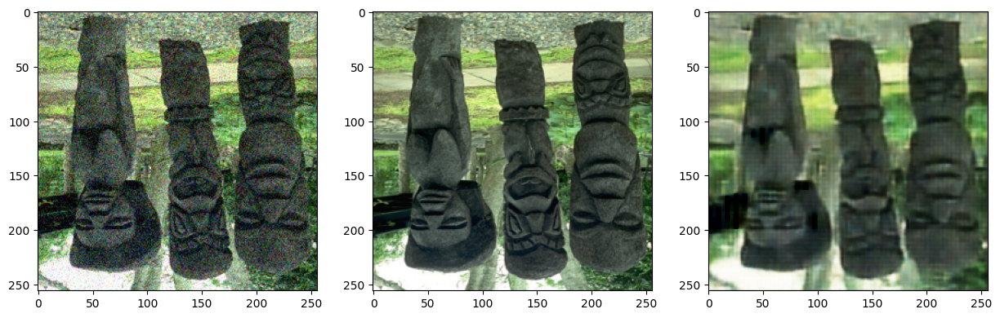

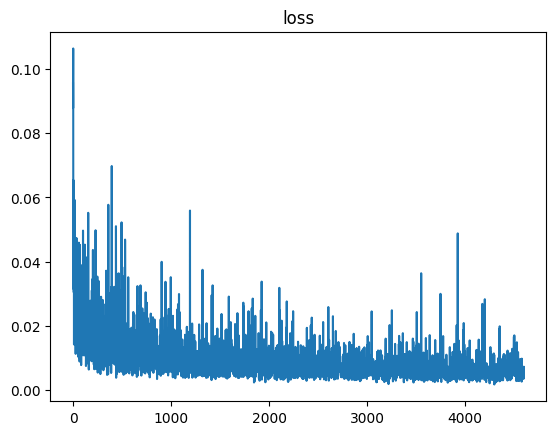

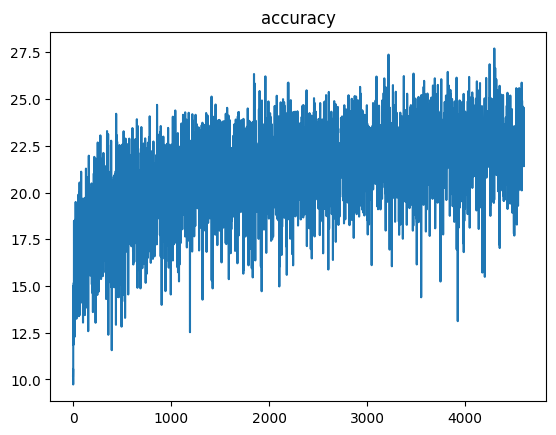

In [4]:
test(model, device, test_set)

print('on train_set: ')
predict(0, model, device, train_set)

plt.title('loss')
plt.plot(loss_list)
plt.show()

plt.title('accuracy')
plt.plot(accuracy_list)
plt.show()

(3, 256, 256)


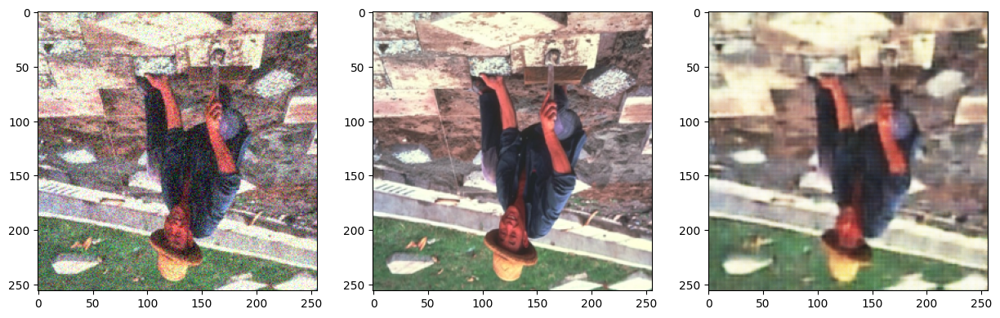

(3, 256, 256)


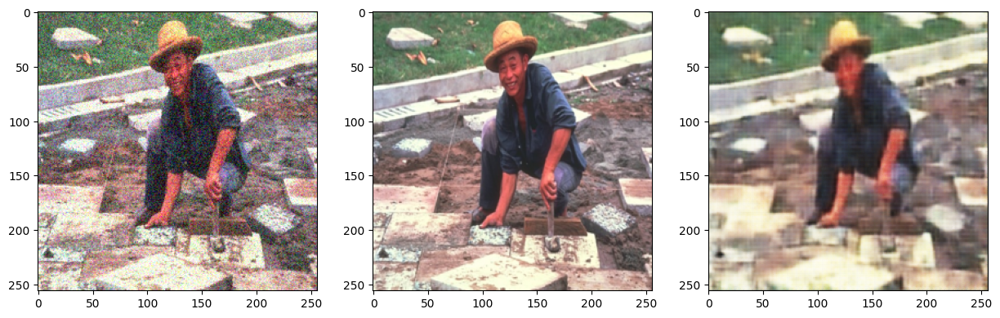

(3, 256, 256)


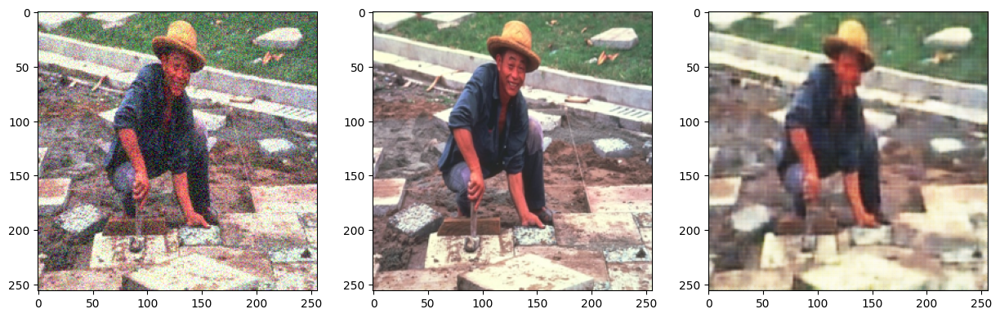

(3, 256, 256)


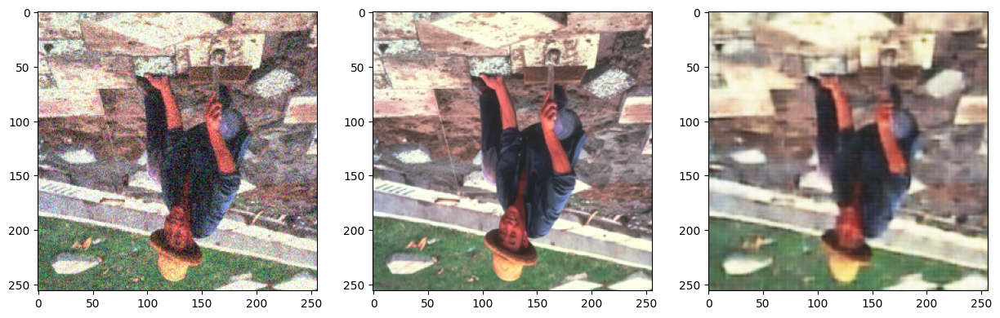

(3, 256, 256)


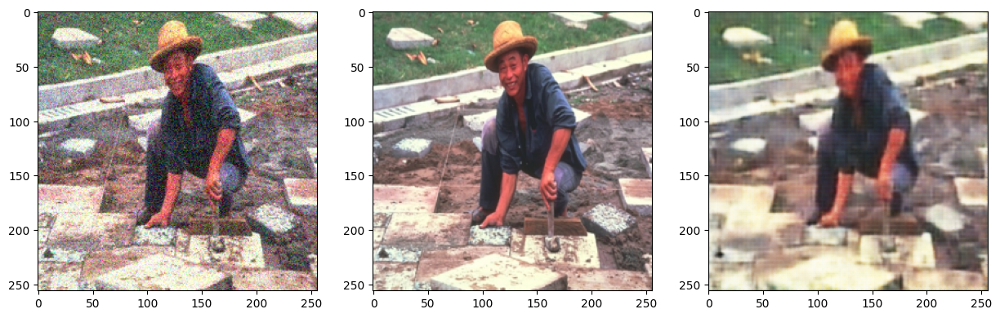

(3, 256, 256)


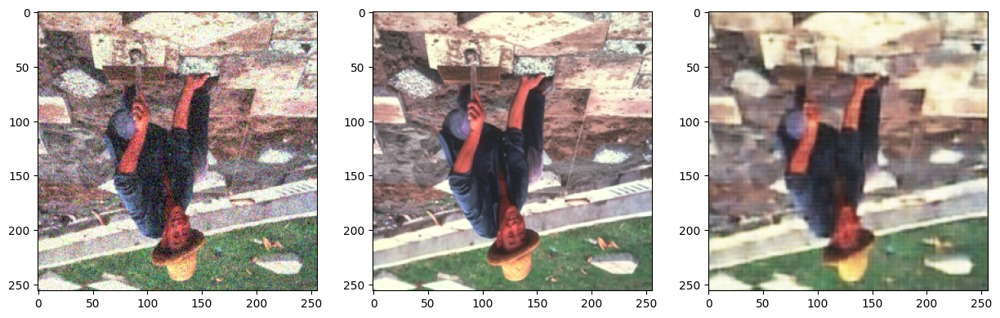

(3, 256, 256)


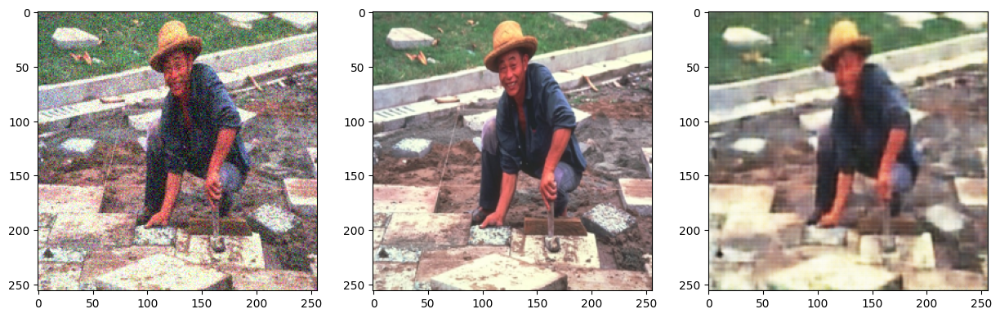

(3, 256, 256)


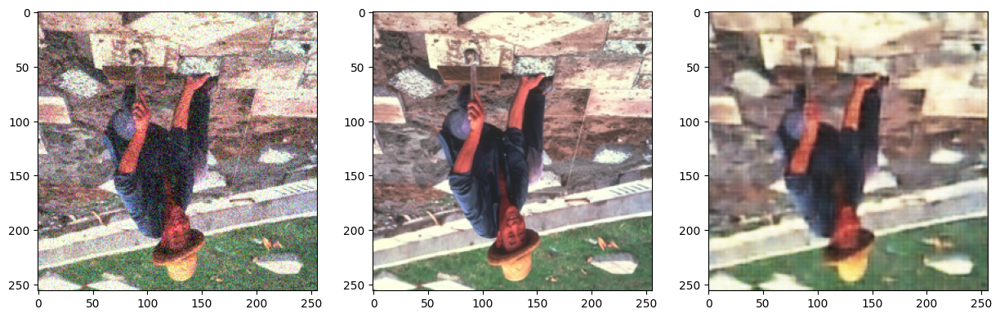

(3, 256, 256)


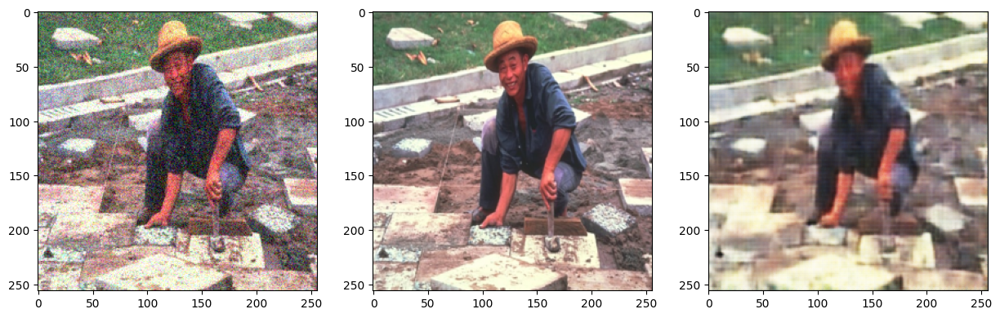

(3, 256, 256)


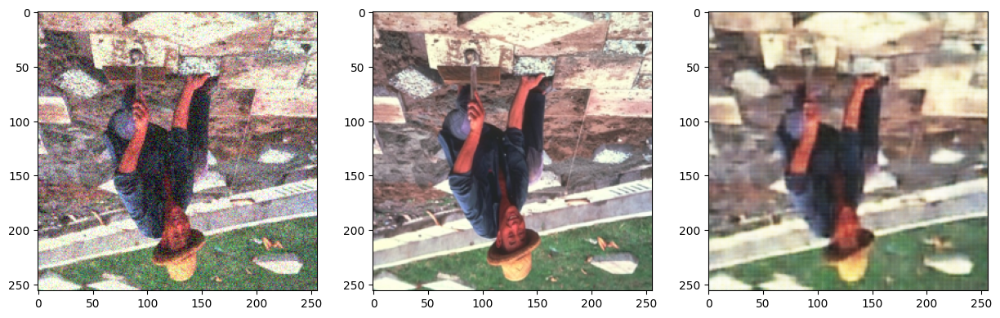

In [5]:
# confirms the random probabilistic nature of transforms
for i in range(10):
    predict(3, model, device, test_set)

layer: 0, shape of w: (32, 3, 3, 3)


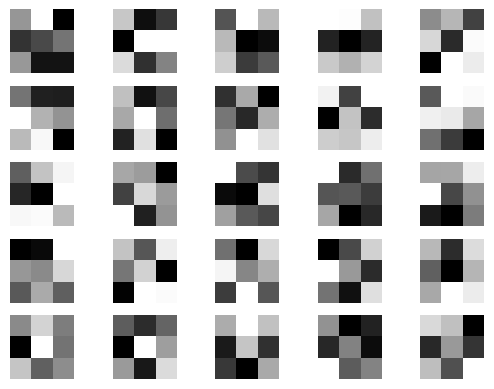

layer: 4, shape of w: (64, 32, 3, 3)


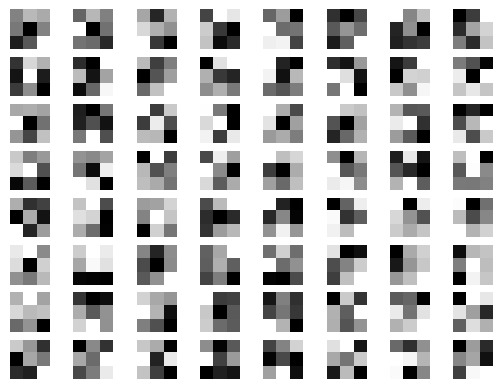

layer: 7, shape of w: (128, 64, 3, 3)


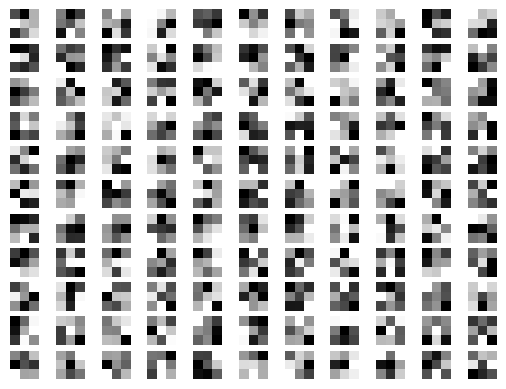

layer: 0, shape of w: (128, 64, 3, 3)


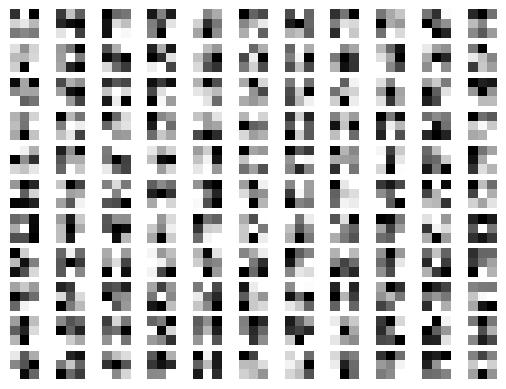

layer: 2, shape of w: (64, 32, 3, 3)


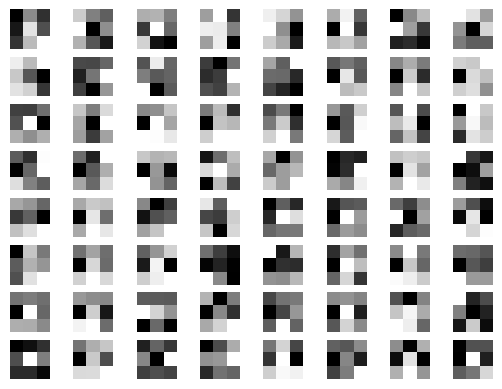

layer: 5, shape of w: (32, 3, 3, 3)


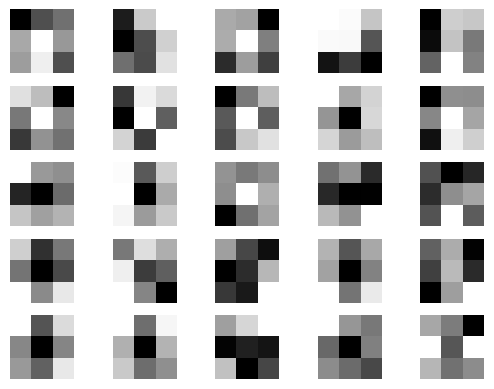

In [18]:
# visualising kernels using matplotlib
for j, encoder_layer in enumerate(model.encoder.children()):
    if isinstance(encoder_layer, nn.Conv2d):
        w = encoder_layer.weight.data.cpu().numpy()
        print(f'layer: {j}, shape of w: {w.shape}')
        w_min = np.min(w)
        w_max = np.max(w)
        fig, ax = plt.subplots(
            ncols = int(np.sqrt(w.shape[0])),
            nrows = int(np.sqrt(w.shape[0]))
        )
        plt.tick_params(
            left = True,
            bottom = True,
            labelleft = True,
            labelbottom = True
        )
        w = (w - w_min) / (w_max - w_min)
        for i, ax in enumerate(ax.flat):
            ax.imshow(w[i][2], cmap='gray')
            ax.axis('off')
        plt.show()

for j, decoder_layer in enumerate(model.decoder.children()):
    if isinstance(decoder_layer, nn.ConvTranspose2d):
        w = decoder_layer.weight.data.cpu().numpy()
        print(f'layer: {j}, shape of w: {w.shape}')
        w_min = np.min(w)
        w_max = np.max(w)
        fig, ax = plt.subplots(
            ncols = int(np.sqrt(w.shape[0])),
            nrows = int(np.sqrt(w.shape[0]))
        )
        plt.tick_params(
            left = True,
            bottom = True,
            labelleft = True,
            labelbottom = True
        )
        w = (w - w_min) / (w_max - w_min)
        for i, ax in enumerate(ax.flat):
            ax.imshow(w[i][1], cmap='gray')
            ax.axis('off')
        plt.show()


torch.Size([1, 3, 256, 256])
torch.Size([3, 256, 256])
torch.Size([1, 128, 32, 32])
(1, 32, 32)


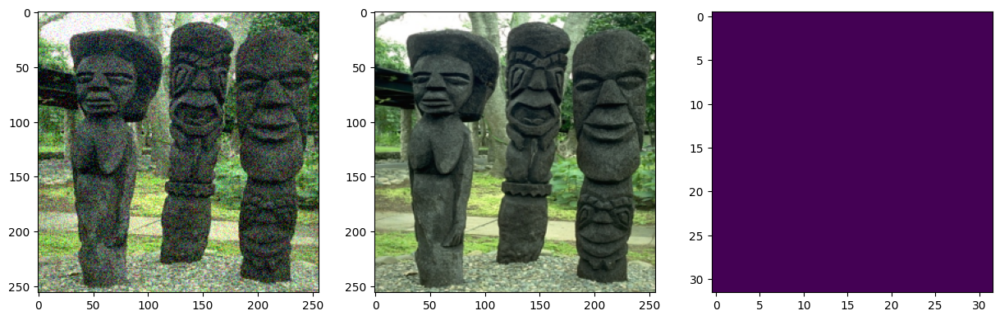

In [47]:
input, target = train_set[0]
print(input.unsqueeze(0).shape)
print(target.shape)
prediction = model.encoder(input.unsqueeze(0))

print(prediction.shape)
imshow_side_by_side(input.cpu(), target.cpu(), prediction[:, 3:4, :, :].cpu())
